In [ ]:
# Crear CSV con todos los resultados de las métricas
# import csv

# file_path = 'evaluation_VAE_results.csv'

# with open(file_path, mode='w', newline='') as file:
#     writer = csv.writer(file)
#     # Escribir encabezados
#     writer.writerow(['model', 'dataset', 'src_spkr', 'tgt_spkr', 'f0_corr', 'mcd', 'FAD'])
    
    

# Evaluación de modelos

## Definición de métricas

In [ ]:
import librosa
import numpy as np
from fastdtw import fastdtw
import csv
import sys
sys.argv = ['']
from frechet_audio_distance import FrechetAudioDistance

def calculate_f0(y):
    f0, _, _ = librosa.pyin(y, fmin=librosa.note_to_hz('C2'), fmax=librosa.note_to_hz('C7'))
    return f0

def rms_normalize(y, target_rms=0.1):
    rms = np.sqrt(np.mean(y**2))
    return y * (target_rms / (rms + 1e-9)) if rms > 0 else y

def calculate_f0_corr(f0_source, f0_target):

    mask1 = ~np.isnan(f0_source) 
    mask2 = ~np.isnan(f0_target)
    f0_source_valid = f0_source[mask1]
    f0_target_valid = f0_target[mask2]

    if len(f0_source_valid) < 2 or len(f0_target_valid) < 2:
        return np.nan
    
    _, path = fastdtw(f0_source_valid, f0_target_valid)

    source_aligned = np.array([f0_source_valid[i] for i, j in path])
    target_aligned = np.array([f0_target_valid[j] for i, j in path])

    return np.corrcoef(source_aligned, target_aligned)[0, 1]


def calculate_mcd(reference_audio, generated_audio, n_mfcc=13, sampling_rate=16000):

    mel_ref = librosa.feature.mfcc(y=reference_audio, sr=sampling_rate, n_mfcc=n_mfcc).T
    mel_ref = mel_ref[:, 1:]

    mel_gen = librosa.feature.mfcc(y=generated_audio, sr=sampling_rate, n_mfcc=n_mfcc).T
    mel_gen = mel_gen[:, 1:]

    if mel_ref.shape != mel_gen.shape:
        _, path = fastdtw(mel_ref, mel_gen)
        mel_ref = np.array([mel_ref[i] for i, j in path])
        mel_gen = np.array([mel_gen[j] for i, j in path])

    dist = np.linalg.norm(mel_ref - mel_gen, axis=1)
    mcd = np.mean(np.sqrt(dist)) 
    return mcd

## Evaluar VAE-GAN

In [ ]:
import tqdm
import os

def evaluate_conversion(source_test_dir, target_test_dir, dataset, version, model, source_spkr, target_spkr, eval_dir_hifi):
    source_audios = os.listdir(source_test_dir)
    generated_audios_hifi = os.listdir(eval_dir_hifi)
    
    corr_total_hifi = []
    mcd_total_hifi = []

    for i in tqdm.tqdm(range(len(source_audios))):
        # Cargar los audios
        y1 = librosa.load(os.path.join(source_test_dir, source_audios[i]), sr=16000)[0]
        y2 = librosa.load(os.path.join(eval_dir_hifi, generated_audios_hifi[i]), sr=16000)[0]

        # Normalizar los audios
        y1 = rms_normalize(y1)
        y2 = rms_normalize(y2)

        f0_source = calculate_f0(y1)
        f0_target = calculate_f0(y2)

        f0_corr_hifi = calculate_f0_corr(f0_source, f0_target)
        corr_total_hifi.append(f0_corr_hifi)

        mcd_hifi = calculate_mcd(y1, y2)
        mcd_total_hifi.append(mcd_hifi)

    # Usamos embeddings con VGGish por defecto
    fad = FrechetAudioDistance(
        use_pca=False,
        sample_rate=16000,
        verbose=True
    )

    # Calculamos el FAD para los audios generados
    fad_score_hifi = fad.score(eval_dir_hifi, target_test_dir)

    corr_total_hifi = np.array(corr_total_hifi)
    mcd_total_hifi = np.array(mcd_total_hifi)


    print(f"Avg F0 corr HiFi: {np.nanmean(corr_total_hifi):.4f}")
    print(f"Avg MCD HiFi: {np.nanmean(mcd_total_hifi):.4f}")
    print(f"FAD HiFi: {fad_score_hifi:.4f}")

    # Guardar los resultados en el CSV
    with open('evaluation_VAE_results.csv', mode='a', newline='') as file:
        writer = csv.writer(file)
        writer.writerow([
            model, f'{dataset}_{version}', source_spkr, target_spkr,
            np.nanmean(corr_total_hifi),
            np.nanmean(mcd_total_hifi),
            np.nanmean(fad_score_hifi)
        ])

In [ ]:
# Directorios con los audios originales de ambos hablantes
SOURCE_TEST_DIR = r'datasets\dataset_2\sing_male_one\test'
TARGET_TEST_DIR = r'datasets\dataset_2\violin\test'

DATASET = 'dataset_2'
VERSION = 'v1'
MODEL = 'd2_v1_model_4_100'
SOURCE_SPKR = '1'
TARGET_SPKR = '2'

EVAL_DIR_HIFI = rf'results/{DATASET}/{VERSION}/{MODEL}/test_results/{SOURCE_SPKR}_{TARGET_SPKR}/HIFI_converted_audios'

evaluate_conversion(SOURCE_TEST_DIR, TARGET_TEST_DIR, DATASET, VERSION, MODEL, SOURCE_SPKR, TARGET_SPKR, EVAL_DIR_HIFI)

In [ ]:
import os
import pickle

RESULTS_DIR = 'results'
DATASETS_DIR = 'datasets'

DATASETS_TO_EVALUATE = [
    'dataset_1', 'dataset_2', 'dataset_3', 'dataset_4', 'dataset_5', 'dataset_6', 'dataset_7']

MODELS_NOT_TO_EVALUATE = {
    'dataset_1': {
        'v1': ['model_1', 'model_2', 'model_3', 'model_4'],
        'v2': ['model_1', 'model_2', 'd1_v2_model_3', 'd1_v2_model_4']
    }
}


for dataset in DATASETS_TO_EVALUATE:
    for version in os.listdir(os.path.join(RESULTS_DIR, dataset)):

        dataset_dir = os.path.join(RESULTS_DIR, dataset, version)
        params_file = os.path.join(DATASETS_DIR, dataset ,version, 'params.txt')
        print(params_file)
        with open(params_file, 'r') as f:
            first_line = f.readline().strip()
            print(first_line)
            if not first_line.startswith('SPEAKERS:'):
                print(f"Invalid params file for {dataset}. Expected 'SPEAKERS: ' at the start.")
                continue
        speakers = eval(first_line.replace('SPEAKERS: ', ''))
        print(f"Evaluating dataset: {dataset} with speakers: {speakers}")

        for model in os.listdir(dataset_dir):
            if model in MODELS_NOT_TO_EVALUATE.get(dataset, {}).get(version, []):
                print(f"Skipping {model} in {dataset} as it is not to be evaluated.")
                continue
            generated_dirs = os.path.join(dataset_dir, model, 'test_results')
            if not os.path.exists(generated_dirs):
                print(f"Skipping {model} in {dataset} as test_results directory does not exist.")
                continue
            for conversion in os.listdir(generated_dirs):
                conversion_dir = os.path.join(generated_dirs, conversion)
                if not os.path.isdir(conversion_dir):
                    continue
                source_spkr, target_spkr = conversion.split('_')
                source_spkr_name = speakers[int(source_spkr)-1]
                target_spkr_name = speakers[int(target_spkr)-1]
                print(f"Evaluating model: {model}, conversion: {conversion}, source: {source_spkr_name}, target: {target_spkr_name}")

                SOURCE_TEST_DIR = os.path.join(DATASETS_DIR, dataset, source_spkr_name, 'test')
                TARGET_TEST_DIR = os.path.join(DATASETS_DIR, dataset, target_spkr_name, 'test')
                EVAL_DIR_HIFI = os.path.join(conversion_dir, 'HIFI_converted_audios')

                evaluate_conversion(
                    SOURCE_TEST_DIR, TARGET_TEST_DIR, dataset, version, model,
                    source_spkr_name, target_spkr_name, EVAL_DIR_HIFI
                )

## Evaluar AUTOVC

In [ ]:
import tqdm
import os

def evaluate_autovc_conversion(source_test_dir, target_test_dir, model, source_spkr, target_spkr, eval_dir_hifi, epoch):
    source_audios = os.listdir(source_test_dir)
    generated_audios_hifi = os.listdir(eval_dir_hifi)
    
    corr_total_hifi = []
    mcd_total_hifi = []

    for i in tqdm.tqdm(range(len(source_audios))):
        # Cargar los audios
        y1 = librosa.load(os.path.join(source_test_dir, source_audios[i]), sr=16000)[0]
        y2 = librosa.load(os.path.join(eval_dir_hifi, generated_audios_hifi[i]), sr=16000)[0]

        # Normalizar los audios
        y1 = rms_normalize(y1)
        y2 = rms_normalize(y2)

        f0_source = calculate_f0(y1)
        f0_target = calculate_f0(y2)

        f0_corr_hifi = calculate_f0_corr(f0_source, f0_target)
        corr_total_hifi.append(f0_corr_hifi)

        mcd_hifi = calculate_mcd(y1, y2)
        mcd_total_hifi.append(mcd_hifi)

    # Usamos embeddings con VGGish por defecto
    fad = FrechetAudioDistance(
        use_pca=False,
        sample_rate=16000,
        verbose=True
    )

    # Calculamos el FAD para los audios generados
    fad_score_hifi = fad.score(eval_dir_hifi, target_test_dir)

    corr_total_hifi = np.array(corr_total_hifi)
    mcd_total_hifi = np.array(mcd_total_hifi)


    print(f"Avg F0 corr HiFi: {np.nanmean(corr_total_hifi):.4f}")
    print(f"Avg MCD HiFi: {np.nanmean(mcd_total_hifi):.4f}")
    print(f"FAD HiFi: {fad_score_hifi:.4f}")

    # Guardar los resultados en el CSV
    with open('evaluation_AUTOVC_results.csv', mode='a', newline='') as file:
        writer = csv.writer(file)
        writer.writerow([
            model,epoch, source_spkr, target_spkr,
            np.nanmean(corr_total_hifi),
            np.nanmean(mcd_total_hifi),
            np.nanmean(fad_score_hifi)
        ])

In [ ]:
import os
import pickle

RESULTS_DIR = r'autovc\results'
DATASETS_DIR = 'datasets'

dataset_mapping = {
    'd4': 'dataset_4',
    'd5': 'dataset_5',
    'd6': 'dataset_6',
    'd7': 'dataset_7',
}

models_to_skip = ['d4_autovc_1', 'd4_autovc_2', 'd5_autovc_1', 'd5_autovc_2', 'd5_autovc_ft', 'd5_autovc_hifi_ft', 'd5_autovc_hifi_ft_train_embs', 'd6_autovc_1', 'd6_autovc_2', 'd6_autovc_ft']
combinations_to_skip = []

for model in os.listdir(RESULTS_DIR):
    if model in models_to_skip:
        print(f"Skipping {model} as it is not to be evaluated.")
        continue
    dataset = dataset_mapping.get(model.split('_')[0], None)
    for child in os.listdir(os.path.join(RESULTS_DIR, model)):
        if os.path.isdir(os.path.join(RESULTS_DIR, model, child)):
            epoch = child.split('-')[-1].split('_')[0]
            print(f"Evaluating model: {model}, epoch: {epoch}, dataset: {dataset}")
            for spkr_src in os.listdir(os.path.join(RESULTS_DIR, model, child)):
                for spkr_tgt in os.listdir(os.path.join(RESULTS_DIR, model, child, spkr_src)):
                    if model == 'd6_autovc_ft' and (spkr_src, spkr_tgt) in combinations_to_skip:
                        print(f"Skipping combination {spkr_src} to {spkr_tgt} for model {model} as it is not to be evaluated.")
                        continue
                    print(f"Evaluating conversion from {spkr_src} to {spkr_tgt} for model {model}, epoch {epoch}, dataset {dataset}")
                    SOURCE_TEST_DIR = os.path.join(DATASETS_DIR, dataset, spkr_src, 'test')
                    TARGET_TEST_DIR = os.path.join(DATASETS_DIR, dataset, spkr_tgt, 'test')
                    EVAL_DIR_HIFI = os.path.join(RESULTS_DIR, model, child, spkr_src, spkr_tgt)

                    evaluate_autovc_conversion(
                        SOURCE_TEST_DIR, TARGET_TEST_DIR, model, spkr_src, spkr_tgt, EVAL_DIR_HIFI, epoch
                    )


# OTROS

## Comparar audios generados

In [51]:
import os
import IPython.display as ipd
import pickle

source_dir_1 = r'data_source\sing_voices_all'
source_dir_2 = r'data_source\violin'

test_refs = pickle.load(open(r'datasets\dataset_3\v1\refs_test.pickle', 'rb'))
# Comparación
dirs = [
    r'results/dataset_3/v1/d3_v1_model_1/test_results/1_2/HIFI_converted_audios',
    r'results/dataset_3/v1/d3_v1_model_1/test_results/1_3/HIFI_converted_audios',
    r'results/dataset_3/v1/d3_v1_model_1/test_results/2_1/HIFI_converted_audios',
    r'results/dataset_3/v1/d3_v1_model_1/test_results/2_3/HIFI_converted_audios',
    r'results/dataset_3/v1/d3_v1_model_1/test_results/3_1/HIFI_converted_audios',
    r'results/dataset_3/v1/d3_v1_model_1/test_results/3_2/HIFI_converted_audios',
    ]

audio_id = 3

original_path_1 = os.path.join(source_dir, sorted(test_refs[0])[audio_id])
original_path_2 = os.path.join(source_dir, sorted(test_refs[1])[audio_id])
original_path_3 = os.path.join(source_dir_2, sorted(test_refs[2])[audio_id])
print('Reproduciendo: ', original_path_1)
ipd.display(ipd.Audio(original_path_1))
print('Reproduciendo: ', original_path_2)
ipd.display(ipd.Audio(original_path_2))
print('Reproduciendo: ', original_path_3)
ipd.display(ipd.Audio(original_path_3))

for dir_path in dirs:
    audio_files = [f for f in os.listdir(dir_path) if f.endswith('.wav')]
    if audio_id < len(audio_files):
        audio_path = os.path.join(dir_path, audio_files[audio_id])
        print(f"Reproduciendo: {audio_path}")
        ipd.display(ipd.Audio(audio_path))
    else:
        print(f"No hay suficientes archivos en {dir_path} para mostrar el audio con ID {audio_id}.")

Reproduciendo:  data_source\sing_voices_all\m10_arpeggios_f_slow_forte_u.wav


Reproduciendo:  data_source\sing_voices_all\f1_arpeggios_f_slow_forte_o.wav


Reproduciendo:  data_source\violin\AuSep_2_vn_36_Rondeau.wav


Reproduciendo: results/dataset_3/v1/d3_v1_model_1/test_results/1_2/HIFI_converted_audios\G2_m10_arpeggios_f_slow_forte_u_mel.wav


Reproduciendo: results/dataset_3/v1/d3_v1_model_1/test_results/1_3/HIFI_converted_audios\G3_m10_arpeggios_f_slow_forte_u_mel.wav


Reproduciendo: results/dataset_3/v1/d3_v1_model_1/test_results/2_1/HIFI_converted_audios\G1_f1_arpeggios_f_slow_forte_o_mel.wav


Reproduciendo: results/dataset_3/v1/d3_v1_model_1/test_results/2_3/HIFI_converted_audios\G3_f1_arpeggios_f_slow_forte_o_mel.wav


Reproduciendo: results/dataset_3/v1/d3_v1_model_1/test_results/3_1/HIFI_converted_audios\G1_AuSep_2_vn_36_Rondeau_mel.wav


Reproduciendo: results/dataset_3/v1/d3_v1_model_1/test_results/3_2/HIFI_converted_audios\G2_AuSep_2_vn_36_Rondeau_mel.wav


## Copiar los archivos de refs_test.pickle al directorio datasets/

In [ ]:
import shutil
import os
import pickle

source_dir = r'data_source'

dataset = 'dataset_2'
version = 'v1'
dataset_path = os.path.join('datasets', dataset, version)

with open(f'{dataset_path}/params.txt', 'r') as f:
    first_line = f.readline().strip()

spkrs = eval(first_line.replace('SPEAKERS: ', ''))

test_refs = pickle.load(open(fr'{dataset_path}\refs_test.pickle', 'rb'))

for spkr in test_refs:
    print(f"Procesando hablante: {spkr}")
    for ref in test_refs[spkr]:
        src_path = os.path.join(source_dir, spkrs[spkr], ref)
        dst_path = os.path.join('datasets', dataset, spkrs[spkr], 'test', ref)
        os.makedirs(os.path.dirname(dst_path), exist_ok=True)
        shutil.copy(src_path, dst_path)
        print(f"Copiado {src_path} a {dst_path}")

Procesando hablante: 0
Copiado data_source\sing_male_one\m1_scales_belt_o.wav a datasets\dataset_2\sing_male_one\test\m1_scales_belt_o.wav
Copiado data_source\sing_male_one\m1_long_inhaled_o.wav a datasets\dataset_2\sing_male_one\test\m1_long_inhaled_o.wav
Copiado data_source\sing_male_one\m1_scales_c_slow_forte_a.wav a datasets\dataset_2\sing_male_one\test\m1_scales_c_slow_forte_a.wav
Copiado data_source\sing_male_one\m1_long_straight_u.wav a datasets\dataset_2\sing_male_one\test\m1_long_straight_u.wav
Copiado data_source\sing_male_one\m1_scales_belt_e.wav a datasets\dataset_2\sing_male_one\test\m1_scales_belt_e.wav
Copiado data_source\sing_male_one\m1_scales_straight_e.wav a datasets\dataset_2\sing_male_one\test\m1_scales_straight_e.wav
Copiado data_source\sing_male_one\m1_arpeggios_f_fast_forte_a.wav a datasets\dataset_2\sing_male_one\test\m1_arpeggios_f_fast_forte_a.wav
Copiado data_source\sing_male_one\m1_row_vibrato.wav a datasets\dataset_2\sing_male_one\test\m1_row_vibrato.wav
C

## Visualizaciones generales

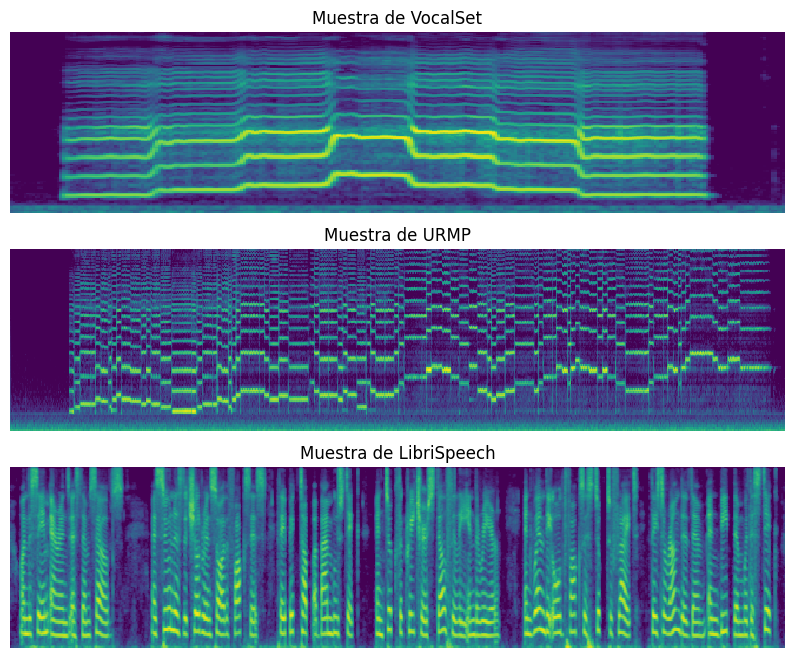

In [ ]:
import os
import librosa.display
import matplotlib.pyplot as plt

path1 = r'data_source\sing_voices_all\arpeggios_straight_a.wav'
path2 = r'data_source\violin\AuSep_1_vn_01_Jupiter.wav'
path3 = r'data_source\read_female_one\7794-295947-0000.flac'

y1, sr1 = librosa.load(path1, sr=22050)
y2, sr2 = librosa.load(path2, sr=22050)
y3, sr3 = librosa.load(path3, sr=22050)

sp1 = librosa.feature.melspectrogram(y=y1, sr=sr1, n_mels=128, fmax=8000)
sp2 = librosa.feature.melspectrogram(y=y2, sr=sr2, n_mels=128, fmax=8000)
sp3 = librosa.feature.melspectrogram(y=y3, sr=sr3, n_mels=128, fmax=8000)

plt.figure(figsize=(10, 8))
plt.subplot(3, 1, 1)
librosa.display.specshow(librosa.power_to_db(sp1, ref=np.max), sr=sr1, x_axis='time', y_axis='mel', fmax=8000, cmap='viridis')
plt.title('Muestra de VocalSet')
plt.axis('off')
plt.subplot(3, 1, 2)
librosa.display.specshow(librosa.power_to_db(sp2, ref=np.max), sr=sr2, x_axis='time', y_axis='mel', fmax=8000, cmap='viridis')
plt.title('Muestra de URMP')
plt.axis('off')
plt.subplot(3, 1, 3)
librosa.display.specshow(librosa.power_to_db(sp3, ref=np.max), sr=sr3, x_axis='time', y_axis='mel', fmax=8000, cmap='viridis')
plt.title('Muestra de LibriSpeech')
plt.axis('off')
plt.show()

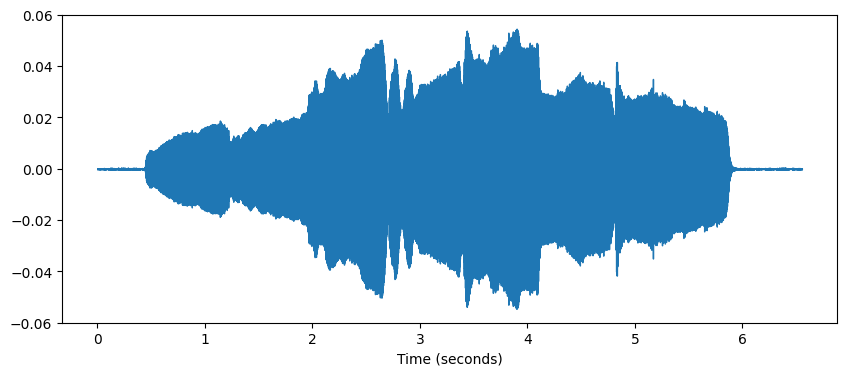

In [47]:

plt.figure(figsize=(10, 4))
librosa.display.waveshow(y1, sr=sr1, axis='s')
plt.show()